In [89]:
import pandas as pd
from Bio.PDB import *

import matplotlib.pyplot as plt
from pylab import *
get_ipython().run_line_magic('matplotlib', 'inline')

# Define some plotting styles that we will use.
fontSize=12
matplotlib.rcParams.update({"axes.formatter.limits": (-4,4),'font.family':'serif','font.size': fontSize, "axes.titlesize": fontSize+2, "xtick.labelsize": fontSize, "ytick.labelsize": fontSize,})
plotStyles={"markersize":20,"markeredgewidth":3.0,"linewidth":3.0}
stepStyles={"markersize":20,"markeredgewidth":3.0,"linewidth":4.0,"where":"post"}
scatterStyles={"linewidth":1.0}

import seaborn as sns

In [ ]:
# Add polynomial features
from sklearn.preprocessing import PolynomialFeatures,StandardScaler
#from sklearn.model_selection import KFold, cross_val_predict
from sklearn.pipeline import Pipeline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn import metrics

from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix, precision_recall_fscore_support, recall_score, precision_score

from sklearn.svm import SVC
from sklearn.preprocessing import MinMaxScaler
#Calculate permutaiion importance
from sklearn.inspection import permutation_importance

In [ ]:
def visulize_feature_importance(importance_array):
    sorted_idx = importance_array. importances_mean.argsort()[-15:]
    
    fig,ax = plt.subplots(dpi=300)
    fig.set_figwidth(8)
    fig.set_figheight(5)
    
    ax.boxplot(importance_array.importances[sorted_idx].T, vert=False, labels=data2_p.iloc[:,:-1].columns[sorted_idx])
    tight_layout()
    fig.savefig('Figure2.png')
    plt.show()
    
def evaluate_metrics(yt,yp):
    results_pos = {}
    results_pos['accuracy'] = accuracy_score(yt, yp)
    precision,recall, f_beta, _ = precision_recall_fscore_support(yt,yp,average='binary')
    results_pos['recall'] = recall
    results_pos['precision'] = precision
    results_pos['f1score'] = f_beta
    return results_pos

In [81]:
#pf = PolynomialFeatures(degree = 2)
s = StandardScaler()


In [250]:
data2r = pd.read_csv('training_set_WT+MT+aSN.txt')

data2 = data2r[data2r.columns[data2r.dtypes!=object]]
st_pka = {
    'GLU':4.25,
    'ASP':3.86,
    'HIS':6.04,
    'CYS':8.33,
    'TYR':10.07,
    'LYS':10.79
}

In [251]:
for ite in data2.index:
    data2.loc[ite, 'pKaO'] = st_pka[data2r.loc[ite, 'ResName']]
    data2.loc[ite,'pKaC'] = int(data2.loc[ite,'pKa'] > st_pka[data2r.loc[ite, 'ResName']])

/tmp/ipykernel_29492/1376418416.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data2.loc[ite, 'pKaO'] = st_pka[data2r.loc[ite, 'ResName']]
/tmp/ipykernel_29492/1376418416.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data2.loc[ite,'pKaC'] = int(data2.loc[ite,'pKa'] > st_pka[data2r.loc[ite, 'ResName']])


In [252]:
data2 = data2.drop('pKa',axis=1).drop('ResID',axis=1)

In [281]:
data2.shape

(1032, 43)

In [185]:
figure2 = sns.pairplot(data2, hue='pKaC')

In [126]:
data2['ResName'].value_counts()

ResName
GLU    373
ASP    317
HIS    185
LYS    125
CYS     17
TYR     15
Name: count, dtype: int64

In [253]:
# Now to classify the data using different methods, K-nearest neighbors, SVM and decision trees

rs = 958
x_train, x_test, y_train, y_test = train_test_split(data2.loc[:,data2.columns != 'pKaC'], data2[['pKaC']],test_size=0.3, stratify=data_y,random_state=rs)



In [ ]:
# K-nearest neighbor


maxk = 50
k_f1_score = []

for k in range(1,maxk+1):
    knn = KNeighborsClassifier(n_neighbors=k)
    
    knn = knn.fit(x_train,y_train.values.ravel())
    preds = knn.predict(x_test)
    
    f1 = f1_score(y_test,preds)
    k_f1_score.append((k,round(f1,4)))
f1_results = pd.DataFrame(k_f1_score, columns= ['K','F1 Score'])
f1_results.set_index('K')

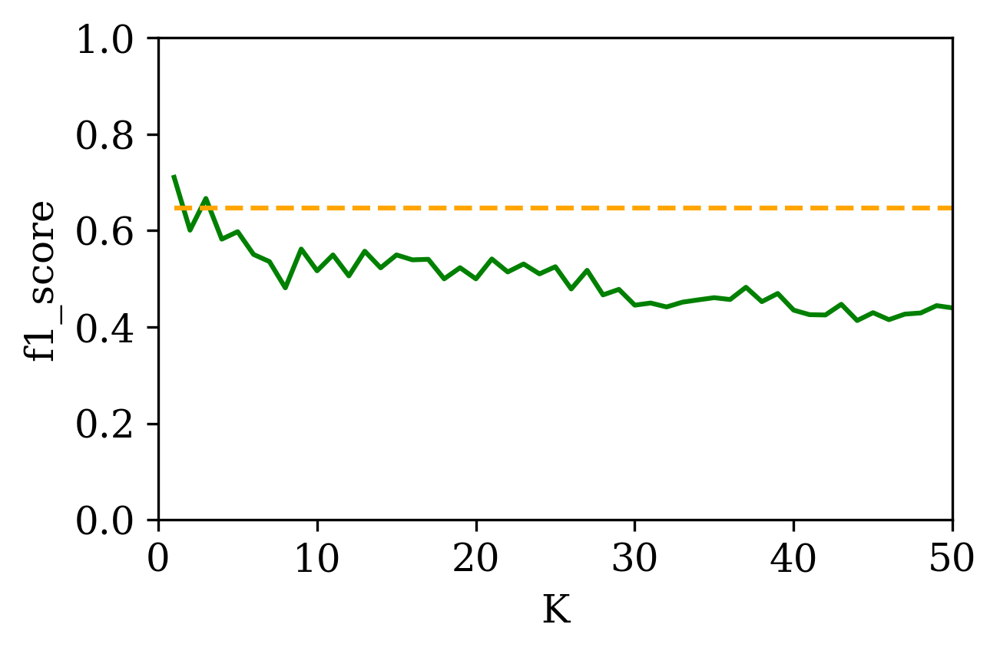

In [273]:
fig1 = plt.figure(figsize = (4.5,3),dpi =300)
ax1 = fig1.add_subplot(1,1,1)

ax1.plot(1+f1_results.index, f1_results['F1 Score'],color='green')
ax1.plot(1+f1_results.index, f1_results.index*0+0.6468,'--', color='orange')
ax1.set_xlabel('K')
ax1.set_ylabel('f1_score')
ax1.set_xlim(0,50)
ax1.set_ylim(0,1)

tight_layout()
fig1.savefig('Figure1.png')

In [257]:
# classify using SVM
params_grid = {
    'C':[1,10,100,1000],
    'kernel':['poly','rbf','sigmoid']

}

model = SVC()

grid_search = GridSearchCV(estimator = model, 
                          param_grid = params_grid, 
                          scoring = 'f1',
                          cv = 4, verbose = 1)

grid_search.fit(x_train, y_train.values.ravel())
best_params = grid_search.best_params_

Fitting 4 folds for each of 12 candidates, totalling 48 fits


In [232]:
best_params

{'C': 1000, 'kernel': 'rbf'}

In [258]:
model = SVC(C=1000, kernel='rbf',probability=True)
model.fit(x_train,y_train.values.ravel())
preds = model.predict(x_test)
evaluate_metrics(y_test,preds)

{'accuracy': 0.6935483870967742,
 'recall': 0.6304347826086957,
 'precision': 0.6641221374045801,
 'f1score': 0.6468401486988848}

In [259]:
knn = KNeighborsClassifier(n_neighbors=1)
    
knn = knn.fit(x_train,y_train.values.ravel())

In [260]:
feature_importances =permutation_importance(estimator = knn, X=x_train, y=y_train,n_repeats =5,random_state=rs,n_jobs=-1)

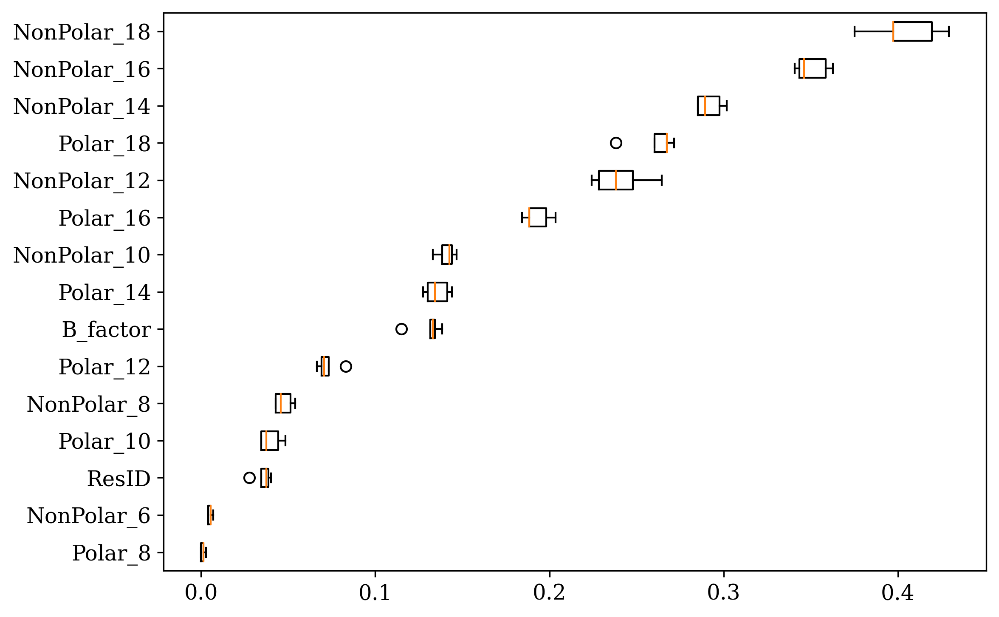

In [280]:
visulize_feature_importance(feature_importances)